In [1]:
import sys
import os
import cv2
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import math

In [2]:
base_path = '/Users/krc/Documents/breast_dacon'

train_df = pd.read_csv('/Users/krc/Documents/breast_dacon/open/train.csv')
test_df = pd.read_csv('/Users/krc/Documents/breast_dacon/open/test.csv')

In [3]:
img_path = base_path + train_df['img_path'].iloc[13][1:]
mask_path = base_path + train_df['mask_path'].iloc[13][1:]
mask_path

'/Users/krc/Documents/breast_dacon/train_masks/BC_01_0015.png'

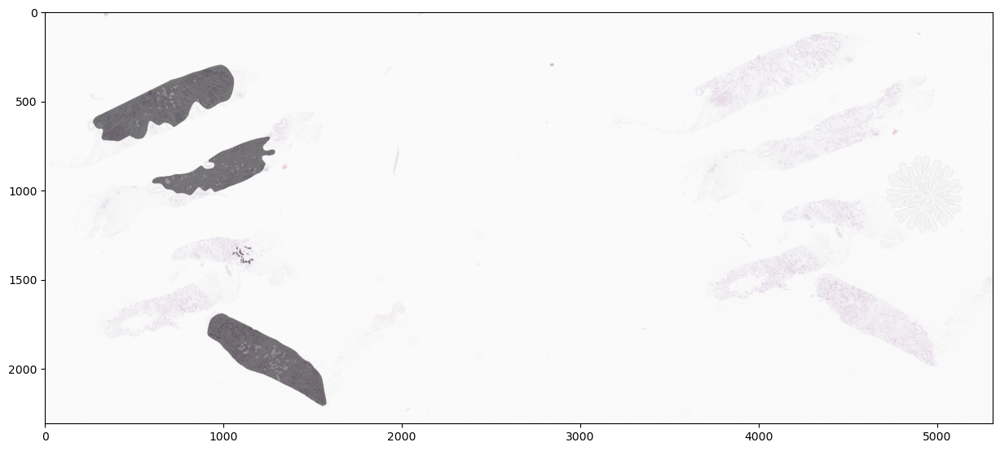

In [4]:
image = cv2.imread(img_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
mask = cv2.imread(mask_path)

plt.figure(figsize = (15,10))

plt.imshow(image, alpha =0.7)
plt.imshow(mask, alpha =0.5)
plt.show()

In [5]:
# mask 가 있는 사진 리스트 
have_mask = train_df[train_df['mask_path'] != '-' ]

mask_list = have_mask.mask_path.values.tolist()
have_mask

,ID,img_path,mask_path,나이,수술연월일,진단명,암의 위치,암의 개수,암의 장경,NG,...,ER_Allred_score,PR,PR_Allred_score,KI-67_LI_percent,HER2,HER2_IHC,HER2_SISH,HER2_SISH_ratio,BRCA_mutation,N_category
13,BC_01_0015,./train_imgs/BC_01_0015.png,./train_masks/BC_01_0015.png,43,2019-02-11,4,1,2,13.0,2.0,...,7.0,1.0,8.0,10.01,0.0,2.0,0.0,1.23,NaN,0
80,BC_01_0397,./train_imgs/BC_01_0397.png,./train_masks/BC_01_0397.png,60,2020-01-08,1,2,1,23.0,2.0,...,7.0,1.0,6.0,20.22,0.0,0.0,NaN,NaN,NaN,1
81,BC_01_0398,./train_imgs/BC_01_0398.png,./train_masks/BC_01_0398.png,58,2019-12-12,1,2,1,13.0,2.0,...,8.0,1.0,5.0,20.93,0.0,1.0,NaN,NaN,NaN,1
82,BC_01_0404,./train_imgs/BC_01_0404.png,./train_masks/BC_01_0404.png,72,2019-12-26,1,2,1,13.0,2.0,...,7.0,1.0,8.0,6.38,0.0,1.0,NaN,NaN,NaN,1
84,BC_01_0417,./train_imgs/BC_01_0417.png,./train_masks/BC_01_0417.png,51,2019-12-05,1,2,2,21.0,2.0,...,7.0,0.0,NaN,18.86,0.0,2.0,0.0,1.27,NaN,1
86,BC_01_0425,./train_imgs/BC_01_0425.png,./train_masks/BC_01_0425.png,46,2019-12-12,4,1,1,5.0,1.0,...,6.0,1.0,6.0,4.60,0.0,2.0,0.0,1.10,NaN,0
88,BC_01_0451,./train_imgs/BC_01_0451.png,./train_masks/BC_01_0451.png,33,2019-11-05,1,2,2,22.0,3.0,...,6.0,1.0,4.0,44.92,0.0,2.0,0.0,1.42,NaN,1
89,BC_01_0454,./train_imgs/BC_01_0454.png,./train_masks/BC_01_0454.png,62,2019-10-22,1,1,1,13.0,2.0,...,7.0,1.0,6.0,11.84,0.0,2.0,0.0,1.32,NaN,1
90,BC_01_0455,./train_imgs/BC_01_0455.png,./train_masks/BC_01_0455.png,46,2019-10-07,1,2,1,14.0,2.0,...,7.0,1.0,8.0,16.37,0.0,1.0,NaN,NaN,NaN,1
91,BC_01_0457,./train_imgs/BC_01_0457.png,./train_masks/BC_01_0457.png,44,2019-10-30,2,2,2,40.0,2.0,...,7.0,1.0,6.0,2.60,0.0,1.0,NaN,NaN,NaN,1


In [40]:
have_mask['img_path'].iloc[0][1:]

'/train_imgs/BC_01_0015.png'

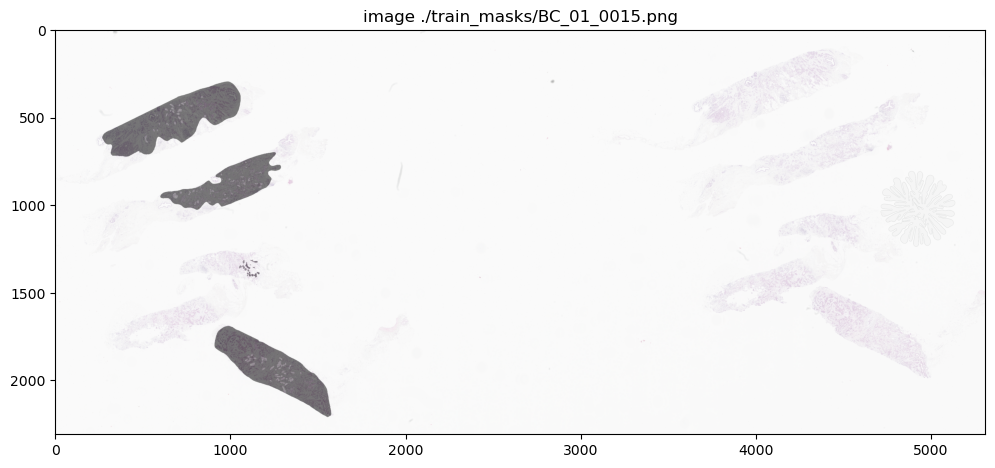

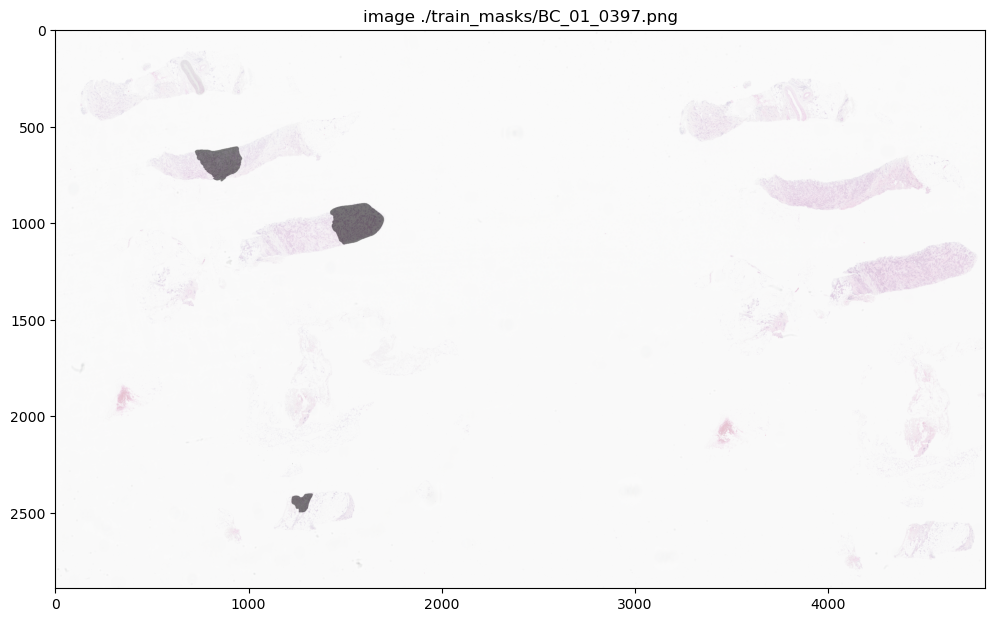

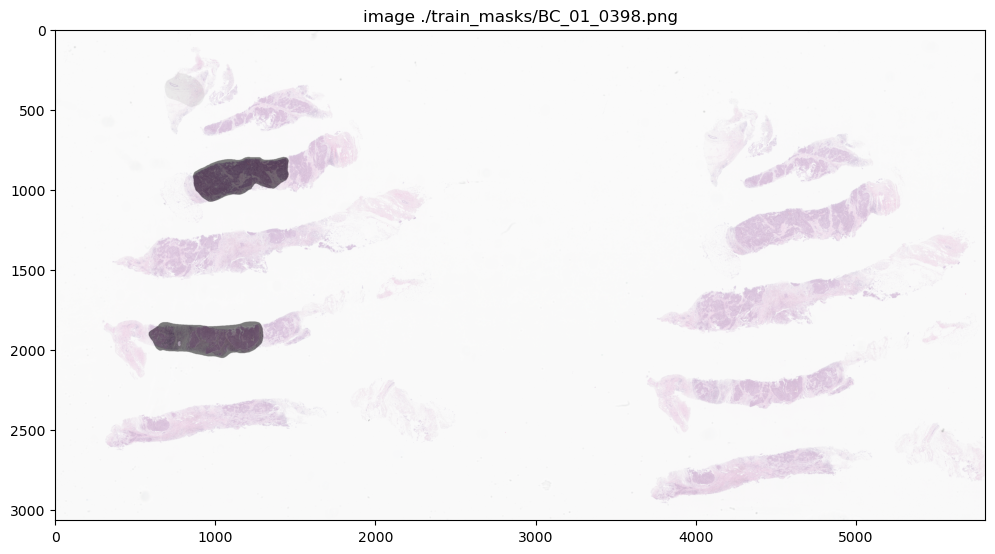

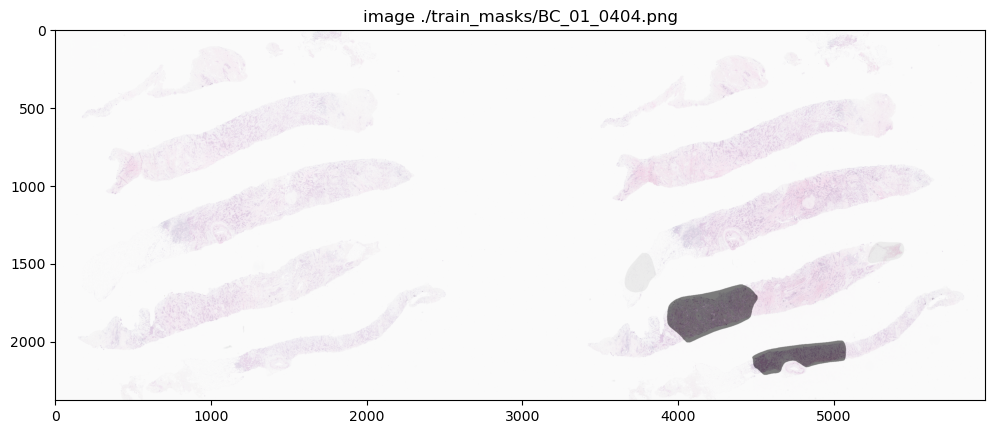

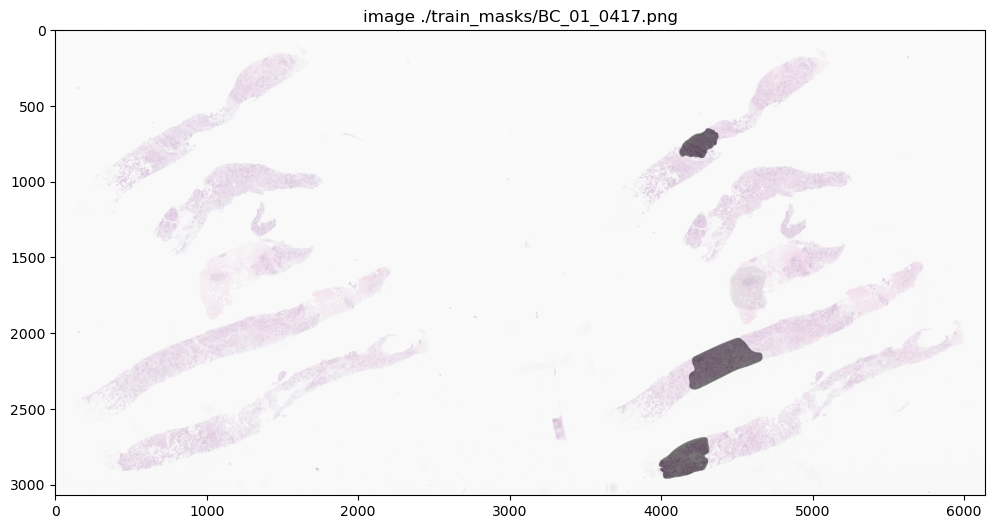

...

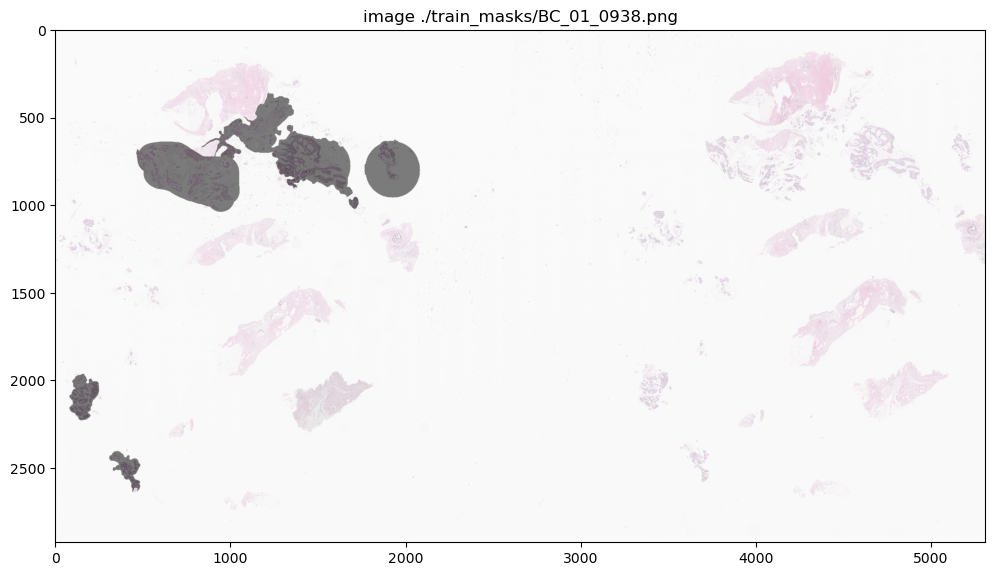

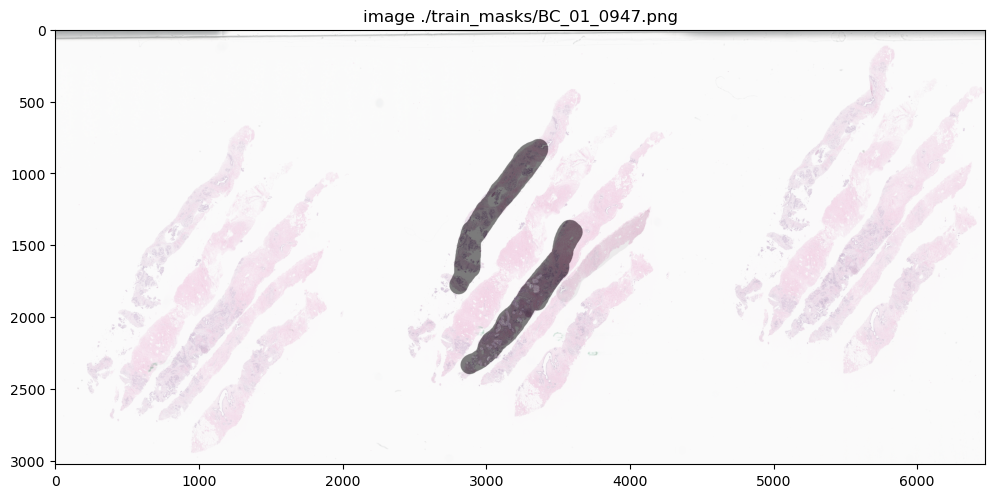

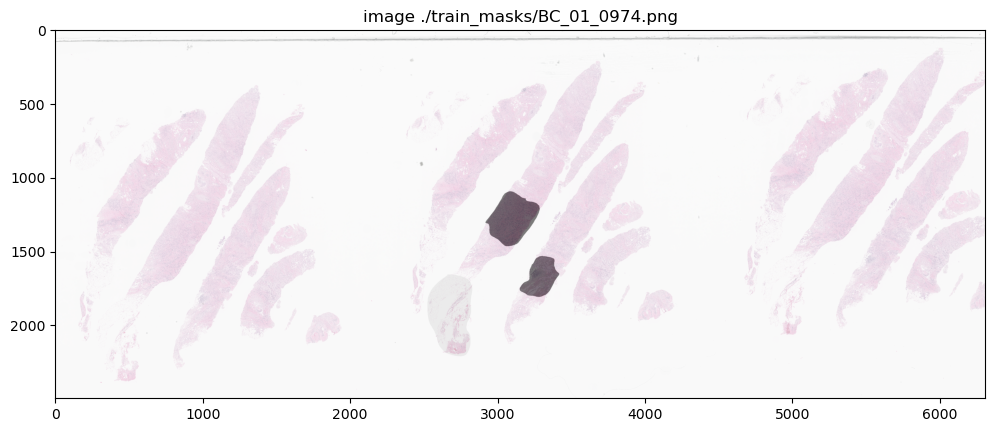

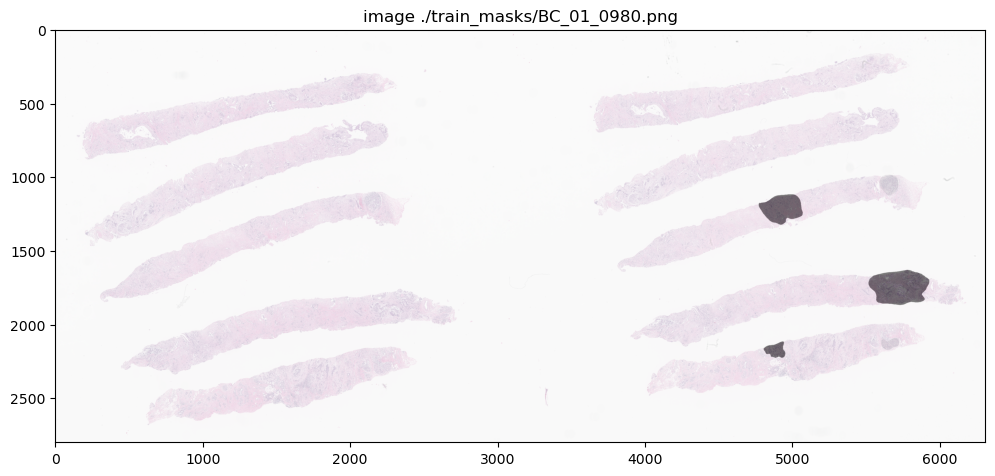

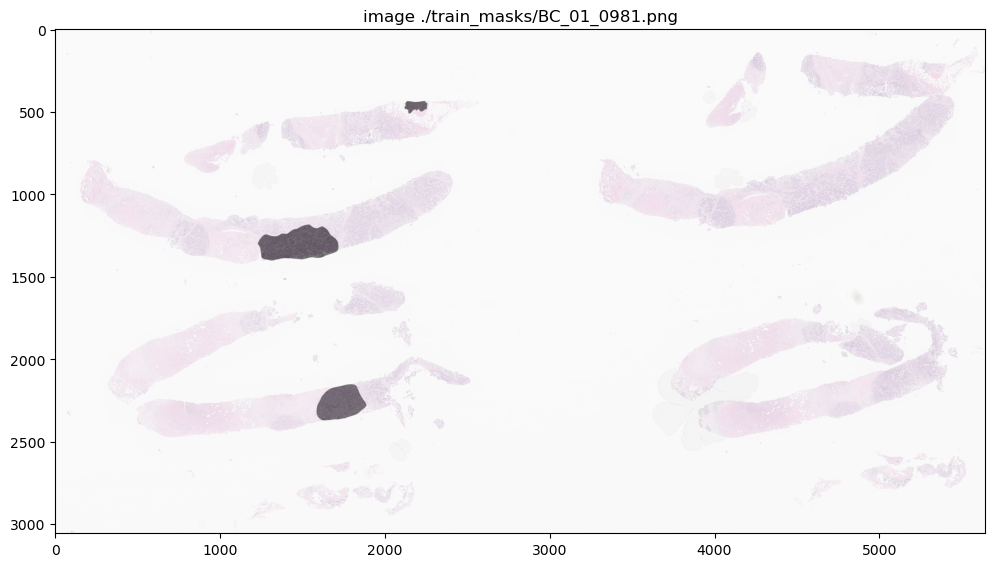

In [42]:
for idx, img in enumerate(mask_list):
    only_img_path = base_path + have_mask['img_path'].iloc[idx][1:]
    only_mask_path = base_path + img[1:]
    image = cv2.imread(only_img_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    mask = cv2.imread(only_mask_path)
    #mask = cv2.cvtColor(mask, cv2.COLOR_GRAYSCALE)
    plt.figure(figsize = (12,8))
    
    plt.title(f'image {img}')
    plt.imshow(image, alpha =0.7)
    plt.imshow(mask, alpha =0.5)
    plt.show()

In [80]:
def line_detect():
    default_file = base_path + train_df['img_path'].iloc[13][1:]
    # filename = argv[0] if len(argv) > 0 else default_file

    # load image
    src = cv2.imread(default_file)

    # load success check
    if src is None:
        print("Error opening image")
        print("Usage: houghline_example.py" + default_file)
        return -1

    dst = cv2.Canny(src, 90, 190, None, 3)  # optimized in milk 019

    # Copy edges to the images that will dispaly the results in BGR
    cdst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
    cdstP = np.copy(cdst)

    lines = cv2.HoughLines(dst, 1, np.pi / 180, 150, None, 0, 0)

    if lines is not None:
        for i in range(0, len(lines)):
            rho = lines[i][0][0]
            theta = lines[i][0][1]
            a = math.cos(theta)
            b = math.sin(theta)
            x0 = a * rho
            y0 = b * rho
            pt1 = (int(x0 + 1000 * (-b)), int(y0 + 1000 * (a)))
            pt2 = (int(x0 - 1000 * (-b)), int(y0 - 1000 * (a)))
            cv2.line(cdst, pt1, pt2, (0, 0, 255), 2, cv2.LINE_AA)

    linesP = cv2.HoughLinesP(dst, 1, np.pi / 180, 50, None, 50, 10)

    if linesP is not None:
        for i in range(0, len(linesP)):
            li = linesP[i][0]
            cv2.line(cdstP, (li[0], li[1]), (li[2], li[3]), (0, 0, 255), 2, cv2.LINE_AA)

    fig, ax = plt.subplots(1,3, figsize = (30,20)) 

    ax[0].imshow(src)
    ax[1].imshow(cdst)
    ax[2].imshow(cdstP)

    plt.show()


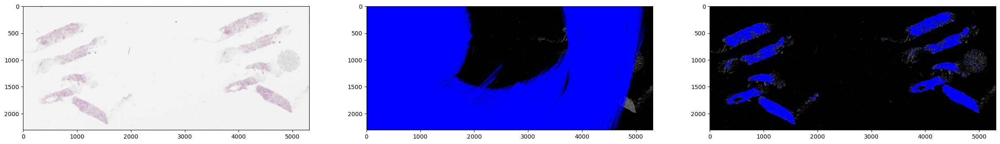

In [81]:
line_detect()

In [7]:
def k_means(file_path):

    file_list = os.walk(file_path)  # OS로 불러오기
    img_files = [file for file in file_list if file[-1][-1].endswith(".png")]
    

    if not img_files:  # if empty folder
        print("there are no png files")
        sys.exit()

    """ # check of printed path 
    for f, g, h in img_files:
        print(f,g,h)
        print(f+'/'+h[0])
    """
    # center stack
    #Z = np.vstack( (1048576,1))

    for i, f in enumerate(img_files[0][2]):
        # t.ly/zgLP
        img = cv2.imread(file_path + "/" + f)
        
        #변환용 마스크
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        mask = cv2.threshold(gray, 239, 255, cv2.THRESH_BINARY)[1]
        mask = 255 - mask
        
        kernel = np.ones((3,3), np.uint8)
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
        
        mask = cv2.GaussianBlur(mask, (0,0), sigmaX=2, sigmaY = 2, borderType = cv2.BORDER_DEFAULT)
        
        #linear stretch - 이건 뭔말인지..
        mask = (2*(mask.astype(np.float32)) - 255.0).clip(0,255).astype(np.uint8)
        
        
        result = img.copy()
        result = cv2.cvtColor(result, cv2.COLOR_BGR2BGRA)
        result[:,:,3] = mask
        
        #main k means
        img = cv2.resize(
            img, dsize=(1024, 1024), interpolation=cv2.INTER_LINEAR)  # image resize
        vectorized = img.reshape((-1, 3))
        vectorized = np.float32(vectorized)
        criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 0.5)
        K = 10  # N of colors
        attempts = 20
        ret, label, center = cv2.kmeans(
            vectorized, K, None, criteria, attempts, cv2.KMEANS_PP_CENTERS
        )
        center = np.uint8(center)
        print(center, center.shape, center[0,:],center[:,0])
        res = center[label.flatten()]
        result_image = res.reshape((img.shape))
        # print(result_image, result_image.shape, np.unique(result_image))
        
        fig, ax = plt.subplots(1,3, figsize = (20,15)) 

        ax[0].imshow(img)
        ax[0].set_title('original')
        ax[1].imshow(result_image)
        ax[1].set_title('result')
        ax[2].imshow(result)
        ax[2].set_title('background deleted')

        plt.show()
        


In [5]:
# 배경 투명화 - 파일 크기는 늘어남 alpha 채널 추가때문에 

def bg_delete(file_path):

    file_list = os.walk(file_path)  # OS로 불러오기
    img_files = [file for file in file_list if file[-1][-1].endswith(".png")]
    

    if not img_files:  # if empty folder
        print("there are no png files")
        sys.exit()

    for i, f in enumerate(img_files[0][2]):
        # t.ly/zgLP
        orig_image = cv2.imread(file_path + f)  
        result = orig_image.copy()
        orig_image = cv2.cvtColor(orig_image, cv2.COLOR_BGR2RGB)
        gray_sample = cv2.cvtColor(orig_image, cv2.COLOR_RGB2GRAY)

        # masked image 
        mask = cv2.threshold(gray_sample, 239, 255, cv2.THRESH_BINARY)[1]
        mask = 255 - mask

        kernel = np.ones((3,3), np.uint8)
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

        mask = cv2.GaussianBlur(mask, (0,0), sigmaX=2, sigmaY = 2, borderType = cv2.BORDER_DEFAULT)

        #linear stretch - 이건 뭔말인지..
        mask = (2*(mask.astype(np.float32)) - 255.0).clip(0,255).astype(np.uint8)



        result = cv2.cvtColor(result, cv2.COLOR_BGR2BGRA)
        result[:,:,3] = mask
    print('done')
    return result

#         fg, ax = plt.subplots(1,2, figsize = (20,15))

#         ax[0].imshow(gray_sample) #, cmap = 'gray')
#         ax[1].imshow(result, cmap = 'gray')
#         plt.show()

[[240 240 240]
 [189 158 206]
 [212 197 220]
 [158 119 168]] (4, 3) [240 240 240] [240 189 212 158]


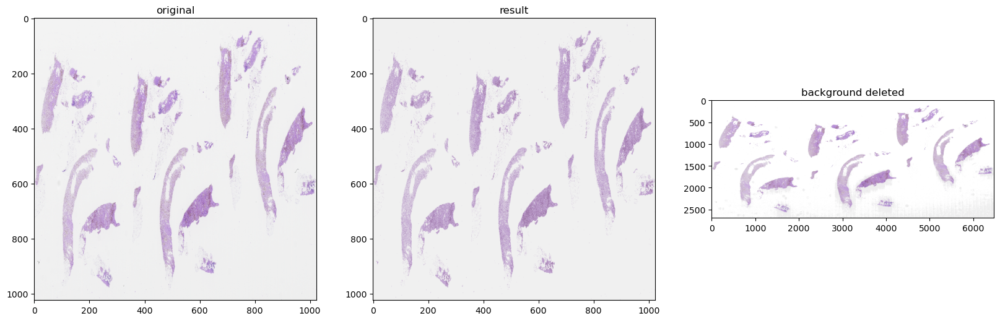

[[241 240 241]
 [203 176 219]
 [221 206 230]
 [176 138 186]] (4, 3) [241 240 241] [241 203 221 176]


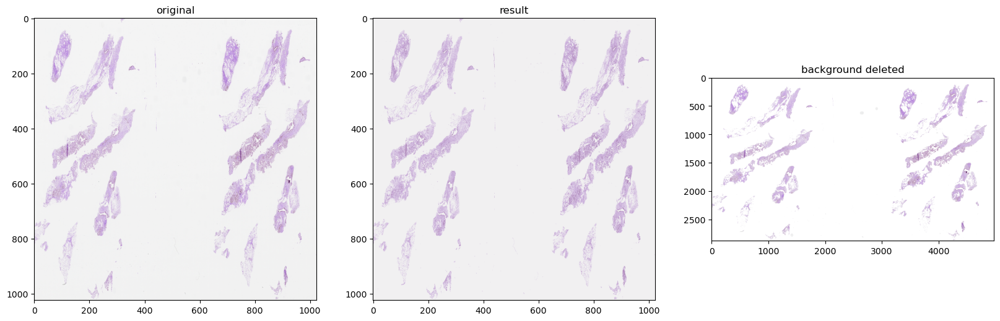

[[241 240 241]
 [195 159 214]
 [162 128 173]
 [214 193 223]] (4, 3) [241 240 241] [241 195 162 214]


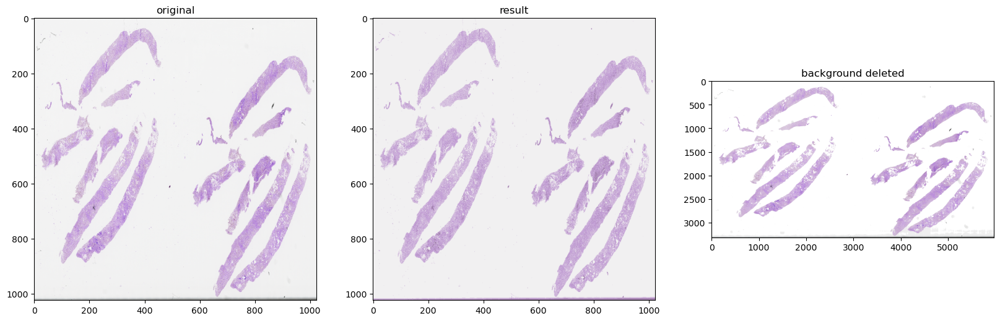

[[240 240 240]
 [195 163 207]
 [214 197 221]
 [168 128 169]] (4, 3) [240 240 240] [240 195 214 168]


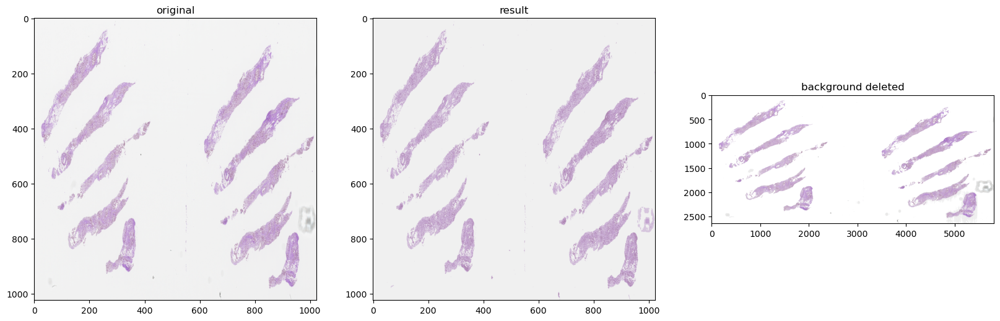

[[208 183 220]
 [240 240 241]
 [ 53  50  47]
 [177 142 186]] (4, 3) [208 183 220] [208 240  53 177]


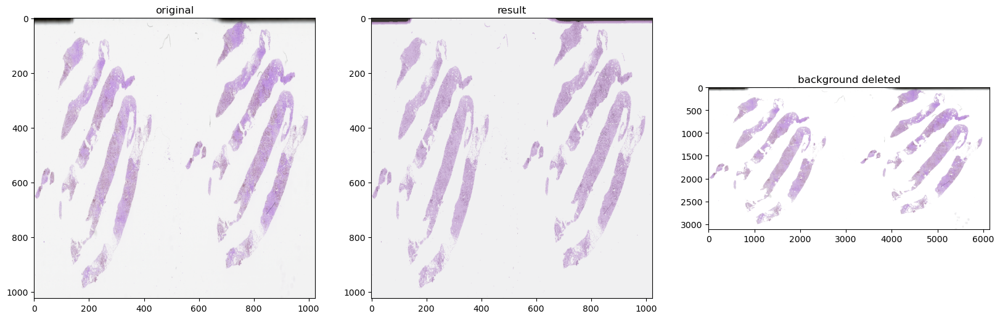

[[240 238 240]
 [170 122 198]
 [205 173 218]
 [130  82 157]] (4, 3) [240 238 240] [240 170 205 130]


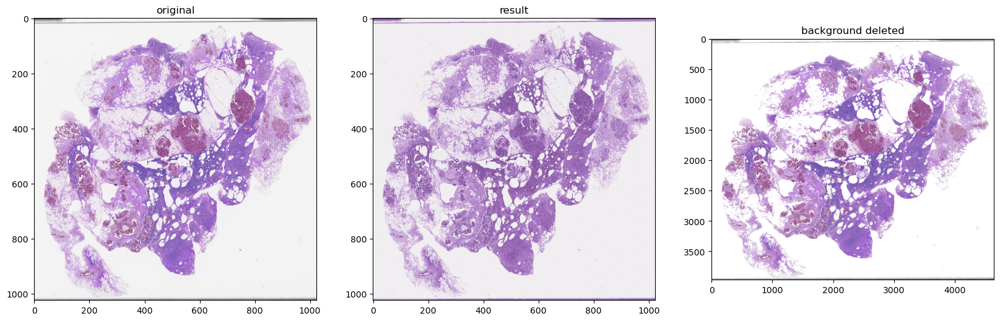

[[240 240 240]
 [156  93 146]
 [188 144 188]
 [214 193 216]] (4, 3) [240 240 240] [240 156 188 214]


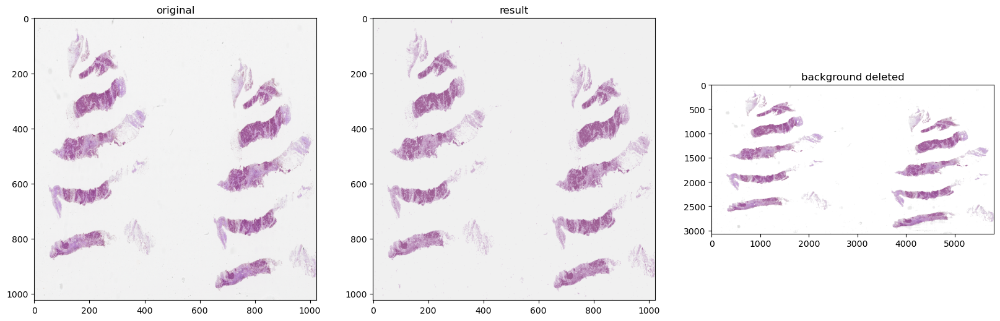

[[192 156 209]
 [240 240 240]
 [166 123 170]
 [214 194 223]] (4, 3) [192 156 209] [192 240 166 214]


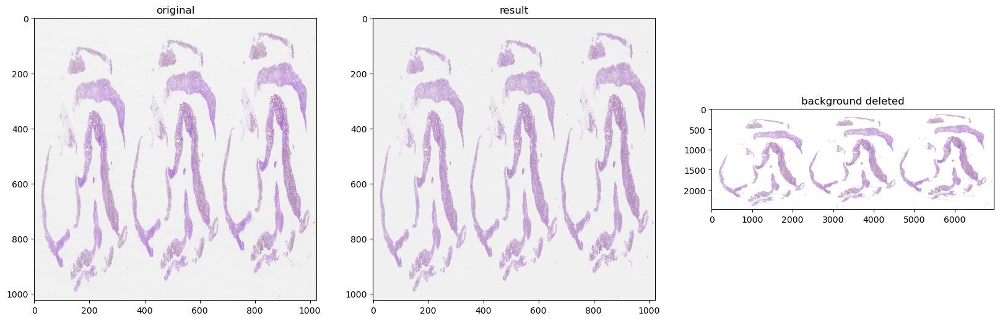

[[241 241 241]
 [176 135 167]
 [225 219 225]
 [207 186 204]] (4, 3) [241 241 241] [241 176 225 207]


KeyboardInterrupt: 

In [8]:
k_means('/Users/krc/Documents/breast_dacon/train_imgs')

(3755, 4813)


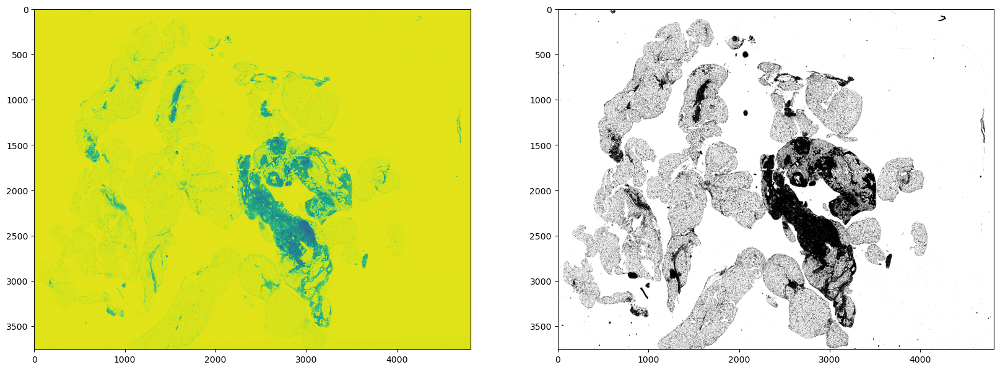

In [235]:
# gray scale 불러오기 
gray_sample = cv2.imread(base_path + train_df['img_path'].iloc[6][1:], cv2.IMREAD_GRAYSCALE)
print(gray_sample.shape)
#gray = cv2.cvtColor(gray_sample, cv2.COLOR_BGR2GRAY)


mask = cv2.threshold(gray_sample, 239, 255, cv2.THRESH_BINARY)[1]

fg, ax = plt.subplots(1,2, figsize = (20,15))

ax[0].imshow(gray_sample) #, cmap = 'gray')
ax[1].imshow(mask, cmap = 'gray')
plt.show()

(2, 396643)


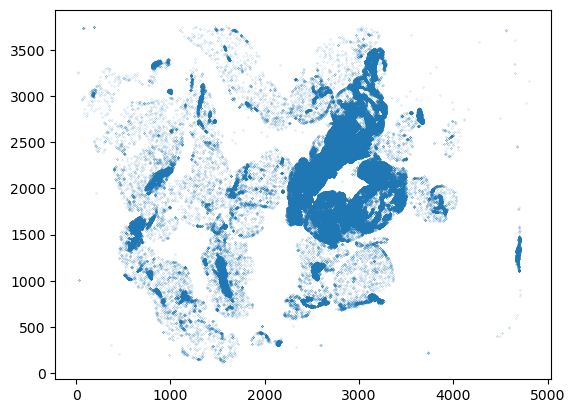

In [236]:


coord = np.where( gray_sample < 140 )
co_array = np.array(coord)
print(co_array.shape)

co_array = np.float32(co_array)

plt.scatter(co_array[1], co_array[0], s=1e-2 )

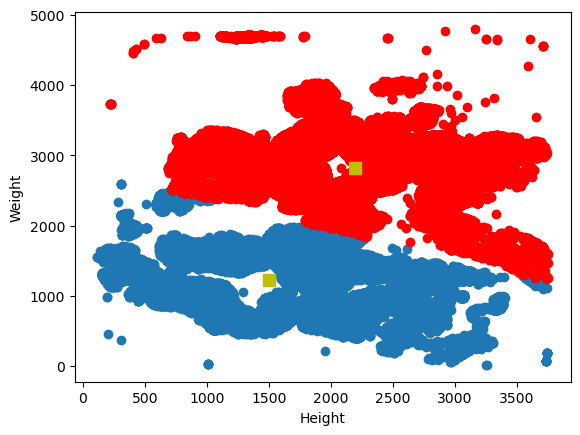

In [216]:
# define criteria and apply kmeans()

co_array = co_array
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
ret,label,center=cv2.kmeans(co_array,2,None,criteria,10,cv2.KMEANS_RANDOM_CENTERS)
# Now separate the data, Note the flatten()
A = co_array[label.ravel()==0]
B = co_array[label.ravel()==1]
# Plot the data
plt.scatter(A[:,0],A[:,1])
plt.scatter(B[:,0],B[:,1],c = 'r')
plt.scatter(center[:,0],center[:,1],s = 80,c = 'y', marker = 's')
plt.xlabel('Height'),plt.ylabel('Weight')
plt.show()

(2308, 5311)


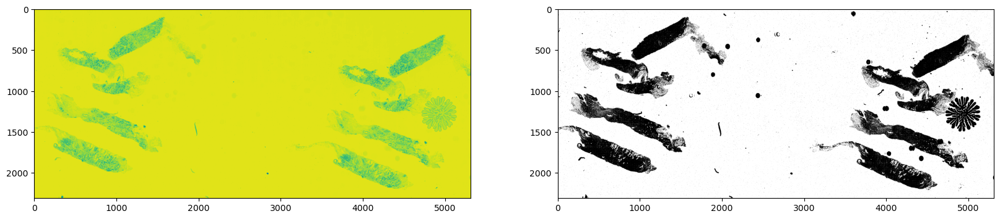

In [157]:
# 2개짜리 cell gray scale 불러오기 
gray_sample = cv2.imread(base_path + train_df['img_path'].iloc[13][1:], cv2.IMREAD_GRAYSCALE)
print(gray_sample.shape)
gray_sample =cv2.flip(gray_sample, 0)

mask = cv2.threshold(gray_sample, 239, 255, cv2.THRESH_BINARY)[1]
# mask =cv2.rotate(mask, cv2.ROTATE_180)

fg, ax = plt.subplots(1,2, figsize = (20,15))

ax[0].imshow(gray_sample) #, cmap = 'gray')
ax[1].imshow(mask, cmap = 'gray')
plt.show()




(2, 29053)


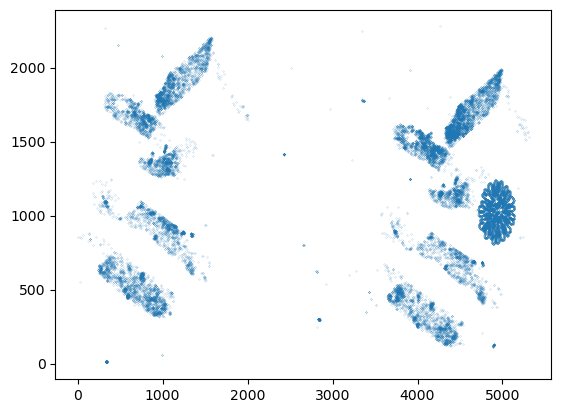

In [152]:
coord = np.where( gray_sample < 120 )
co_array = np.array(coord)
co_array = np.flip(co_array, axis=(0,1))
print(co_array.shape)

co_array = np.float32(co_array)

plt.scatter(co_array[0], co_array[1], s=1e-2 )

[ 919.77734 4526.3965 ] [1235.8965 1116.98  ]


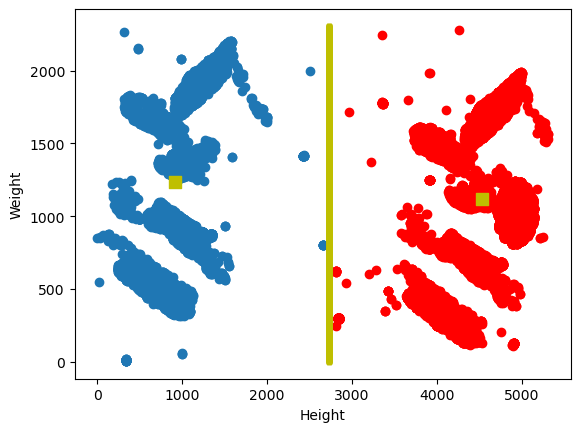

In [163]:
# define criteria and apply kmeans()

co_array = co_array.T
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
ret,label,center=cv2.kmeans(co_array,2,None,criteria,10,cv2.KMEANS_RANDOM_CENTERS)
# Now separate the data, Note the flatten()
A = co_array[label.ravel()==0]
B = co_array[label.ravel()==1]

print(center[:,0],center[:,1])
x = [np.mean(center[:,0])] * 2308

y = [i for i in range(2308)]
# Plot the data
plt.scatter(A[:,0],A[:,1])
plt.scatter(B[:,0],B[:,1],c = 'r')
plt.scatter(center[:,0],center[:,1],s = 80,c = 'y', marker = 's')
plt.scatter(x,y,s = 10,c = 'y', marker = 's')
plt.xlabel('Height'),plt.ylabel('Weight')
plt.show()

--- 

## resize (background delete) - K means - score evaluation - apply crop

In [4]:
os.getcwd()

'/Users/krc/Documents/breast_dacon/dacon_bc_prediction'

In [5]:
from numpy.linalg import norm
import copy 

#From t.ly/TLq_


class KMeans():
    def __init__(self, n_clusters, max_iter = 20, random_state = 27):
        self.n_clusters = n_clusters
        self.max_iter = max_iter
        self.random_state = random_state
        
    def initialize_centroids(self, X): # center 초기화 - 이미지 내 특정 점으로 고정
        np.random.RandomState(self.random_state)
        random_idx = np.random.permutation(X.shape[0])
        centroids = X[random_idx[:self.n_clusters]]

        return centroids
        
    def compute_centroids(self, X, labels): # centroids 계산 
        centroids = np.zeros((self.n_clusters, X.shape[1]))
        for k in range(self.n_clusters):
            centroids[k, :] = np.mean(X[labels == k, :], axis=0)
        return centroids
        
    def compute_distance(self, X, centroids): #
        distance = np.zeros((X.shape[0], self.n_clusters))
        for k in range(self.n_clusters):
            row_norm = norm(X - centroids[k, :], axis=1)
            distance[:, k] = np.square(row_norm)
        return distance
    
    def find_closest_cluster(self, distance):
        return np.argmin(distance, axis=1)
    
    def compute_sse(self, X, labels, centroids):
        distance = np.zeros(X.shape[0])
        for k in range(self.n_clusters):
            distance[labels == k] = norm(X[labels == k] - centroids[k], axis=1)
        return np.sum(np.square(distance))
    
    def fit(self, X):
        self.centroids = self.initialize_centroids(X)
 
        for i in range(self.max_iter):
            old_centroids = self.centroids
            distance = self.compute_distance(X, old_centroids)
            self.labels = self.find_closest_cluster(distance)
            self.centroids = self.compute_centroids(X, self.labels)
            if np.all(old_centroids == self.centroids):
                break
        self.error = self.compute_sse(X, self.labels, self.centroids)
        # return self.labels
        
    def predict(self, X):
        distance = self.compute_distance(X, self.centroids)
        return self.find_closest_cluster(distance)

K =  4 avg_score: 0.45947048
K =  3 avg_score: 0.48830158
K =  2 avg_score: 0.50131357
[[ 81.43476868  59.73654175]
 [113.1212616  193.37864685]
 [ 86.72594452 324.49765015]]


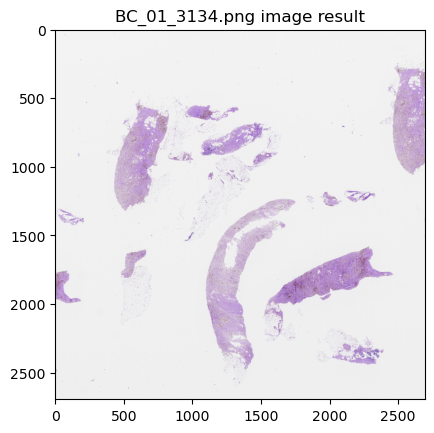

K =  4 avg_score: 0.39940226
K =  3 avg_score: 0.5436186
K =  2 avg_score: 0.7051146
[[109.32136536  75.10638428]
 [110.03251648 320.79574585]]


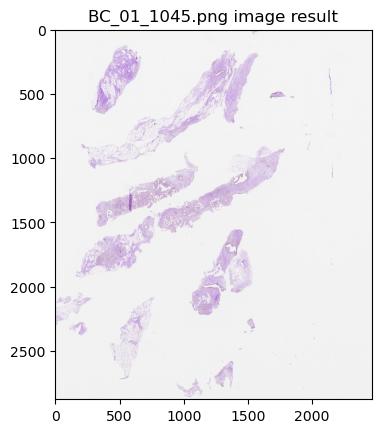

K =  4 avg_score: 0.38469803
K =  3 avg_score: 0.4964757
K =  2 avg_score: 0.6373189
[[ 97.04637146  99.82246399]
 [ 75.55081177 314.53848267]]


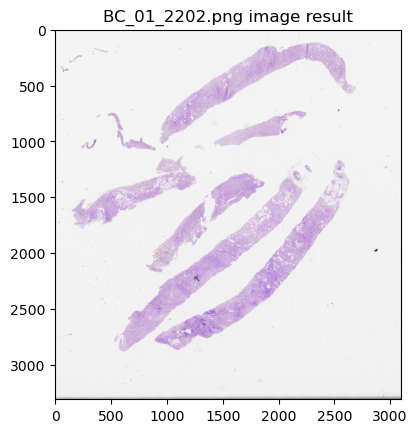

K =  4 avg_score: 0.51383895
K =  3 avg_score: 0.55652887
K =  2 avg_score: 0.68951035
[[ 98.49259186  87.2514267 ]
 [ 84.4900589  323.01321411]]


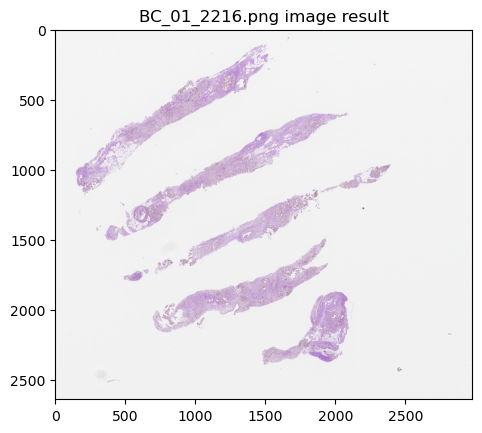

K =  4 avg_score: 0.48986036
K =  3 avg_score: 0.5241974
K =  2 avg_score: 0.665905
[[122.76972961  93.92260742]
 [111.93877411 314.77719116]]


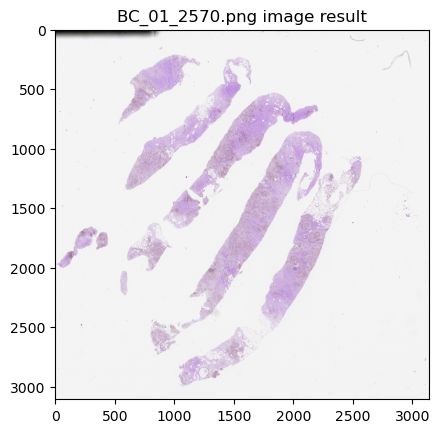

BC_01_1092.png is not cropped
K =  4 avg_score: 0.52028483
K =  3 avg_score: 0.5536456
K =  2 avg_score: 0.6827161
[[ 83.21035004  85.81406403]
 [102.8576355  317.87701416]]


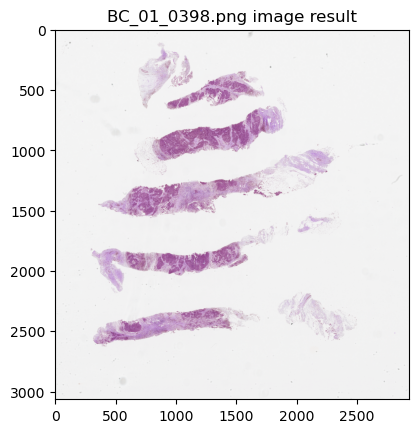

K =  4 avg_score: 0.4700811
K =  3 avg_score: 0.48036996
K =  2 avg_score: 0.50346214
[[ 91.42531586  81.77324677]
 [102.50149536 214.67140198]
 [ 99.25805664 339.52087402]]


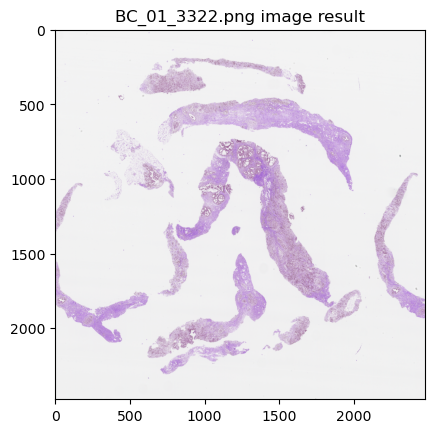

K =  4 avg_score: 0.5783014
K =  3 avg_score: 0.5644218
K =  2 avg_score: 0.73583716
[[137.93977356  80.54664612]
 [ 66.96561432 302.4425354 ]]


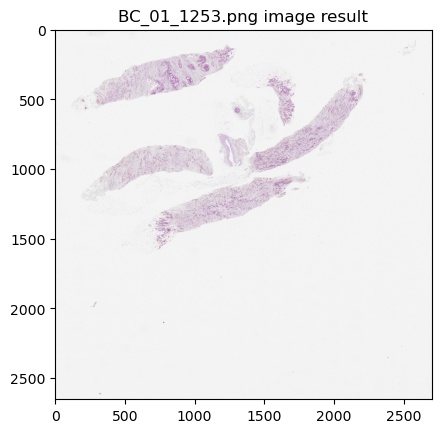

K =  4 avg_score: 0.4140598
K =  3 avg_score: 0.44900432
K =  2 avg_score: 0.5624865
[[ 86.58042145  97.48860168]
 [ 84.13401794 287.69863892]]


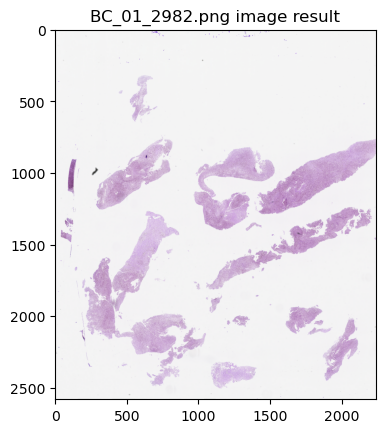

K =  4 avg_score: 0.46031177
K =  3 avg_score: 0.5443393
K =  2 avg_score: 0.66301984
[[116.73988342  88.54180145]
 [124.04135132 300.43838501]]


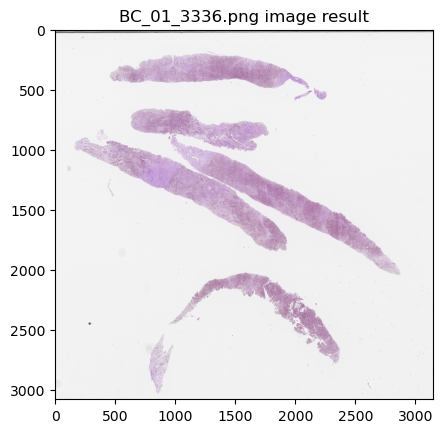

K =  4 avg_score: 0.44665644
K =  3 avg_score: 0.5870436
K =  2 avg_score: 0.6817004
[[ 82.05867767  97.23242188]
 [106.50996399 320.62255859]]


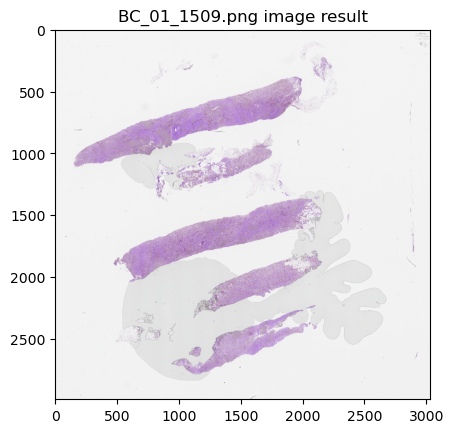

K =  4 avg_score: 0.520813
K =  3 avg_score: 0.5446159
K =  2 avg_score: 0.7190801
[[119.42328644  74.65505219]
 [ 93.13337708 316.03564453]]


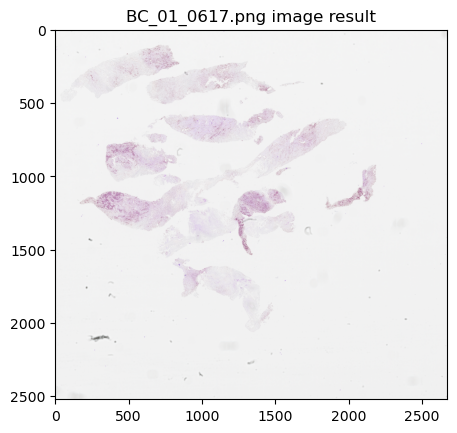

K =  4 avg_score: 0.38629833
K =  3 avg_score: 0.5071186
K =  2 avg_score: 0.6652364
[[101.36590576  90.02388763]
 [103.38516998 297.79272461]]


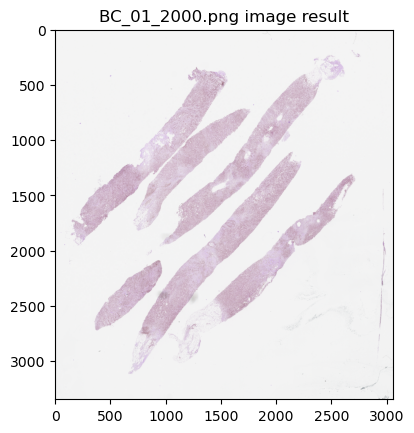

K =  4 avg_score: 0.51927197
K =  3 avg_score: 0.6445943
K =  2 avg_score: 0.7579732
[[109.67826843 102.32205963]
 [ 67.78755188 329.44744873]]


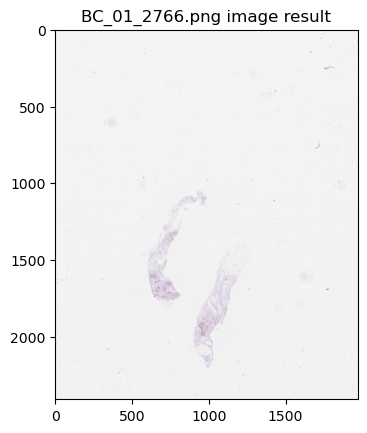

K =  4 avg_score: 0.41944996
K =  3 avg_score: 0.43775755
K =  2 avg_score: 0.6024373
[[ 98.26303864 101.93605804]
 [100.38034821 291.71066284]]


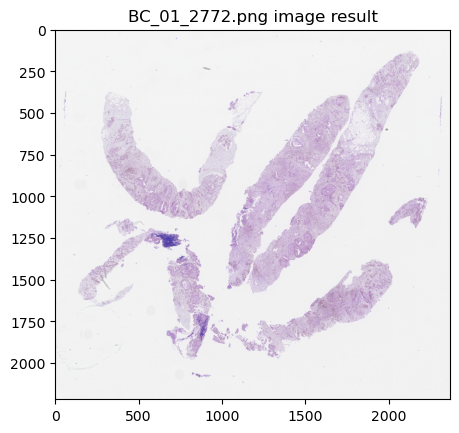

K =  4 avg_score: 0.46287957
K =  3 avg_score: 0.49104157
K =  2 avg_score: 0.5323907
[[104.48525238  50.43606567]
 [ 90.9492569  178.59671021]
 [108.44075012 318.93984985]]


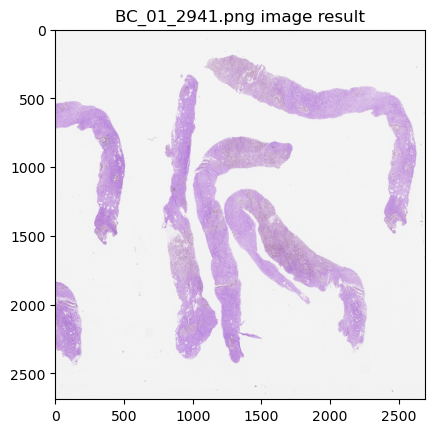

K =  4 avg_score: 0.40982664
K =  3 avg_score: 0.453891
K =  2 avg_score: 0.5285993
[[ 98.56951904  67.5111084 ]
 [100.54691315 198.51921082]
 [104.10118866 329.13253784]]


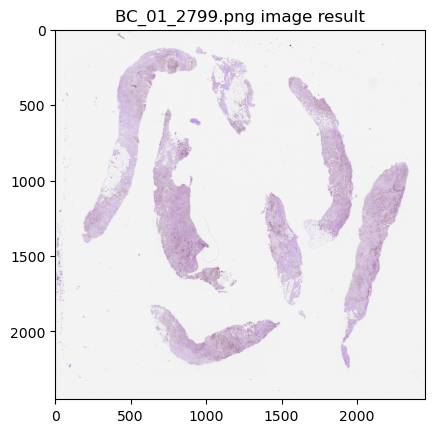

K =  4 avg_score: 0.40429756
K =  3 avg_score: 0.51206285
K =  2 avg_score: 0.6624857
[[ 92.20101929  83.08592987]
 [ 90.03720856 289.34765625]]


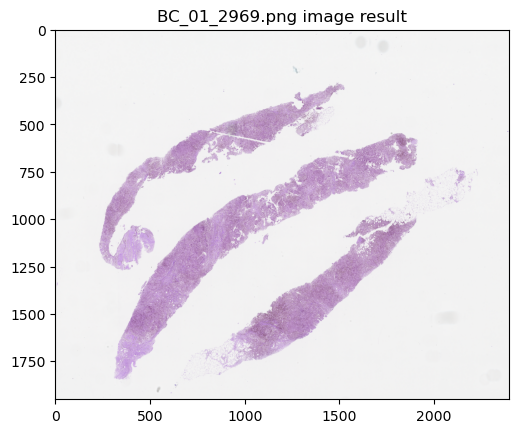

K =  4 avg_score: 0.42230058
K =  3 avg_score: 0.49601567
K =  2 avg_score: 0.64291346
[[ 96.24676514  88.53659058]
 [ 99.44186401 317.2989502 ]]


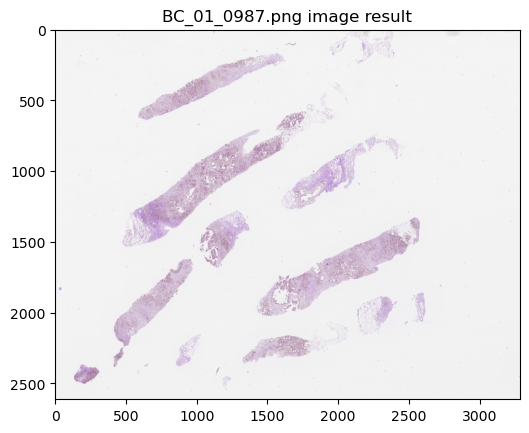

K =  4 avg_score: 0.3607535


In [ ]:
file_path = '/Users/krc/Documents/breast_dacon/train_imgs/'
file_list = os.walk(file_path)  # OS로 불러오기
img_files = [file for file in file_list if file[-1][-1].endswith(".png")]

score_dict = {}

if not img_files:  # if empty folder
    print("there are no png files")
    sys.exit()

for i, f in enumerate(img_files[0][2]):
    # t.ly/zgLP
    image = cv2.imread(file_path + f)
    y_orig, x_orig, channel= image.shape
    if x_orig / y_orig < 1.5:
        print(f'{f} is not cropped')
        continue
    gray_sample = image.copy()
    gray_sample = cv2.cvtColor(gray_sample, cv2.COLOR_RGB2GRAY)
    
    # 모양 맞추기 flip 
    gray_sample =cv2.flip(gray_sample, 0)
    # resize to 400 * 200
    gray_sample = cv2.resize(gray_sample, dsize=(400, 200), interpolation=cv2.INTER_LINEAR) 
    
    #전처리
    coord = np.where( gray_sample < 239 )
    co_array = np.array(coord)
    co_array = np.float32(co_array).T
    from sklearn.metrics import silhouette_samples, silhouette_score

    best_score = 0
    best_k = 1
    x1, x2 = 0, 0
    best_centroids = []
    score_list = []
    for j, k in enumerate([ 4, 3, 2]):

        # Run the Kmeans algorithm
        km = KMeans(n_clusters=k)
        km.fit(co_array)
        labels = km.predict(co_array) # input data

        centroids = km.compute_centroids(co_array, labels) # cluster_centers_
        # Get silhouette samples
        silhouette_vals = silhouette_samples(co_array, labels)

        # Get the average silhouette score and plot it
        avg_score = np.mean(silhouette_vals) ## score 
        score_list.append(avg_score)
        print('K = ',k, 'avg_score:', avg_score)

        if best_score < avg_score:
            if best_k == 3 and k ==2 and (avg_score-best_score) < 0.09:
                break
            best_score = avg_score
            best_k = k
            best_centroids = centroids
            x_coord = centroids[ : , 1]
            x_coord.sort()        
            if best_k == 2:
                x1, x2 = x_coord
            elif best_k ==3  :
                x1, x2, x3 = x_coord
            elif best_k ==4  :
                x1, x2, x3, x4 = x_coord

    score_dict[f] = copy.deepcopy(score_list)
    score_list.clear()
    if best_k == 2:
        crop_image = image[:, : int( (x1+x2)/2  *x_orig / 400 ), :]
    elif best_k > 2:
        # crop_image = image[:, int((x1+x2)/2 * x_orig/400): int((x2+x3/2)*x_orig/400), : ]
        # crop_image = image[:, int((x1+x3)/2 * x_orig/400) : , : ] #x1, x3 사이가 중간점
        alpha = int(y_orig / 2)
        try:
            crop_image = image[:, int(x2 *x_orig /400) -alpha  :int(x2 *x_orig /400) +alpha , : ]
        except: # almost ValueError
            crop_image = image[:, int(((x1+x2)/2) * x_orig/400) : int(((x2+x3)/2)*x_orig/400), : ]
        
    print(best_centroids)
    plt.title(f'{f} image result')
    plt.imshow(crop_image)
    plt.show()
    
    

In [12]:
score_dict 

{'BC_01_3134.png': [0.45947048, 0.48830158, 0.501308],
 'BC_01_1045.png': [0.5332583, 0.5436186, 0.7051146],
 'BC_01_2202.png': [0.46656305, 0.4964757, 0.6373189],
 'BC_01_2216.png': [0.549833, 0.5673973, 0.68951035],
 'BC_01_2570.png': [0.39701447, 0.52419627, 0.665905],
 'BC_01_0398.png': [0.49879208, 0.5536456, 0.6827161],
 'BC_01_3322.png': [0.463455, 0.4803733, 0.50334024],
 'BC_01_1253.png': [0.5783006, 0.5614813, 0.73583716],
 'BC_01_2982.png': [0.42205727, 0.4491227, 0.5624865],
 'BC_01_3336.png': [0.5306364, 0.5443393, 0.66301984],
 'BC_01_1509.png': [0.52866805, 0.5324566, 0.6817004],
 'BC_01_0617.png': [0.36291775, 0.52844733, 0.7190801],
 'BC_01_2000.png': [0.48676997, 0.50713706, 0.6652364],
 'BC_01_2766.png': [0.59711576, 0.58829385, 0.7579732],
 'BC_01_2772.png': [0.37130606, 0.44400302, 0.6024373],
 'BC_01_2941.png': [0.45433897, 0.4910265, 0.5323907],
 'BC_01_2799.png': [0.38680148, 0.453891, 0.5285993],
 'BC_01_2969.png': [0.519775, 0.5178426, 0.6624857],
 'BC_01_0987

In [16]:
score_df = pd.DataFrame.from_dict(score_dict, orient='index', columns = ['K=4','K=3','K=2'])
score_df

,K=4,K=3,K=2
BC_01_3134.png,0.459470,0.488302,0.501308
BC_01_1045.png,0.533258,0.543619,0.705115
BC_01_2202.png,0.466563,0.496476,0.637319
BC_01_2216.png,0.549833,0.567397,0.689510
BC_01_2570.png,0.397014,0.524196,0.665905
...,...,...,...
BC_01_3111.png,0.472215,0.501903,0.522081
BC_01_1706.png,0.385900,0.538138,0.698484
BC_01_2233.png,0.511043,0.520870,0.698789
BC_01_3139.png,0.530023,0.561989,0.506745


In [17]:
score_df.describe()

,K=4,K=3,K=2
count,946.000000,946.000000,946.000000
mean,0.480060,0.535985,0.620624
std,0.059753,0.048541,0.078554
min,0.306057,0.383959,0.474221
25%,0.438354,0.507683,0.537129
50%,0.489866,0.536110,0.643457
75%,0.523979,0.565839,0.688350
max,0.697490,0.765909,0.788063


--- 
### experimental code for crop

In [27]:
base_path + train_df['img_path'].iloc[938][1:]

'/Users/krc/Documents/breast_dacon/train_imgs/BC_01_3134.png'

6474 2695


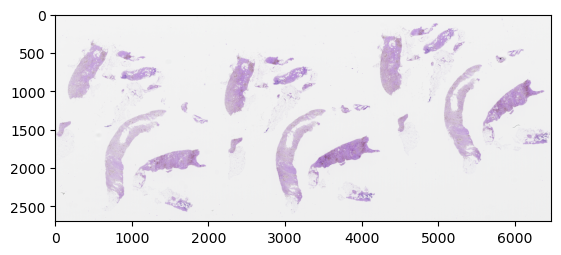

In [29]:
# image load and save the shape
file = base_path + train_df['img_path'].iloc[938][1:]
image = cv2.imread(file)
y_orig, x_orig, channel= image.shape
print(x_orig, y_orig)


plt.imshow(image)
plt.show()

(2695, 6474)
(2, 9625)


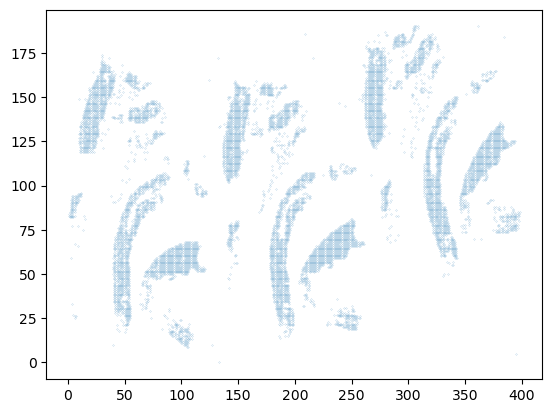

In [30]:
# gray scale, resize, 좌표화
gray_sample = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
print(gray_sample.shape)
gray_sample =cv2.flip(gray_sample, 0)

gray_sample = cv2.resize(gray_sample, dsize=(400, 200), interpolation=cv2.INTER_LINEAR) 

mask = cv2.threshold(gray_sample, 235, 255, cv2.THRESH_BINARY)[1]

coord = np.where( gray_sample < 220 )
co_array = np.array(coord)
print(co_array.shape)

co_array = np.float32(co_array)

plt.scatter(co_array[1], co_array[0], s=1e-2 )

In [31]:
from numpy.linalg import norm

#From t.ly/TLq_


class KMeans():
    def __init__(self, n_clusters, max_iter = 30, random_state = 60):
        self.n_clusters = n_clusters
        self.max_iter = max_iter
        self.random_state = random_state
        
    def initialize_centroids(self, X): # center 초기화 - 이미지 내 특정 점으로 고정
        np.random.RandomState(self.random_state)
        random_idx = np.random.permutation(X.shape[0])
#         fixed_points = np.array(
#             [[X.shape[0]*2/5,  X.shape[0]*4/5 ,X.shape[1]*1/5, X.shape[1]*3/5], 
#             [X.shape[1]/2, X.shape[1]/2, X.shape[1]/2, X.shape[1]/2]]
#             , dtype = int)
#         centroids = fixed_points[:self.n_clusters]
        centroids = X[random_idx[:self.n_clusters]]
        return centroids
        
    def compute_centroids(self, X, labels): # centroids 계산 
        centroids = np.zeros((self.n_clusters, X.shape[1]))
        for k in range(self.n_clusters):
            centroids[k, :] = np.mean(X[labels == k, :], axis=0)
        return centroids
        
    def compute_distance(self, X, centroids): #
        distance = np.zeros((X.shape[0], self.n_clusters))
        for k in range(self.n_clusters):
            row_norm = norm(X - centroids[k, :], axis=1)
            distance[:, k] = np.square(row_norm)
        return distance
    
    def find_closest_cluster(self, distance):
        return np.argmin(distance, axis=1)
    
    def compute_sse(self, X, labels, centroids):
        distance = np.zeros(X.shape[0])
        for k in range(self.n_clusters):
            distance[labels == k] = norm(X[labels == k] - centroids[k], axis=1)
        return np.sum(np.square(distance))
    
    def fit(self, X):
        self.centroids = self.initialize_centroids(X)
 
        for i in range(self.max_iter):
            old_centroids = self.centroids
            distance = self.compute_distance(X, old_centroids)
            self.labels = self.find_closest_cluster(distance)
            self.centroids = self.compute_centroids(X, self.labels)
            if np.all(old_centroids == self.centroids):
                break
        self.error = self.compute_sse(X, self.labels, self.centroids)
        # return self.labels
        
    def predict(self, X):
        distance = self.compute_distance(X, self.centroids)
        return self.find_closest_cluster(distance)

In [32]:
co_array =co_array.T

K=4 :  0.48816726
K=3 :  0.51466775


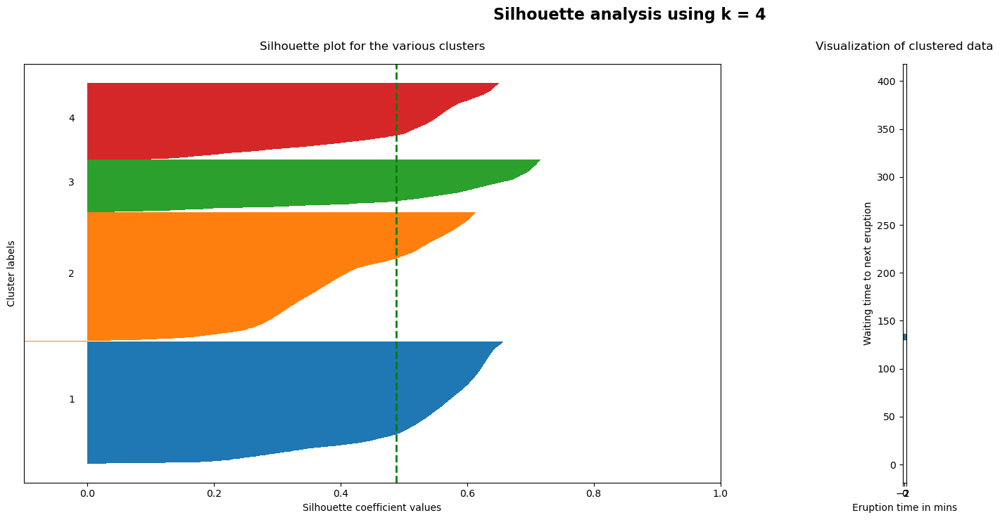

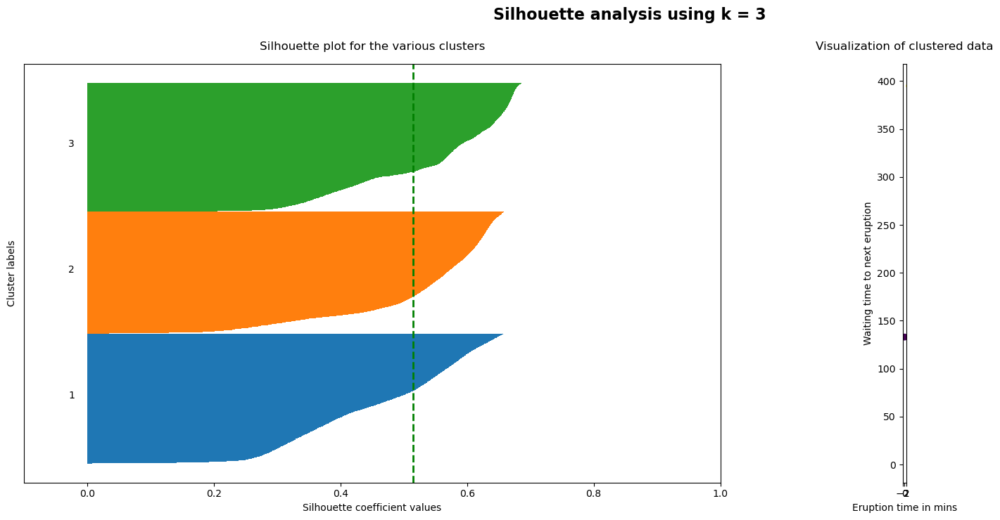

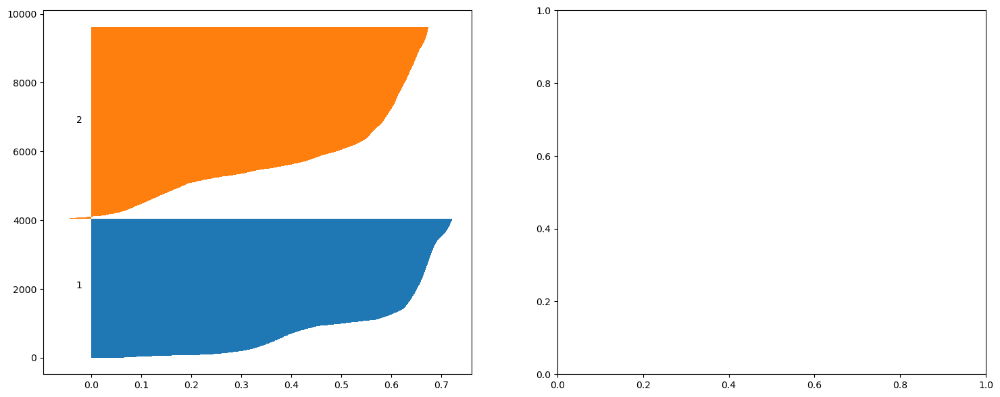

In [34]:
# K mean evaluation with silhoueete analysis 
#data = co_array

from sklearn.metrics import silhouette_samples, silhouette_score

best_score = 0
best_k = 1
x1, x2 = 0, 0
best_centroids = []

for i, k in enumerate([4, 3, 2]):

    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)
    
    # Run the Kmeans algorithm
    km = KMeans(n_clusters=k)
    km.fit(co_array)
    labels = km.predict(co_array) # input data

    centroids = km.compute_centroids(co_array, labels) 

    # Get silhouette samples
    silhouette_vals = silhouette_samples(co_array, labels)

    # Silhouette plot
    y_ticks = []
    y_lower, y_upper = 0, 0
    for i, cluster in enumerate(np.unique(labels)):
        cluster_silhouette_vals = silhouette_vals[labels == cluster]
        cluster_silhouette_vals.sort()
        y_upper += len(cluster_silhouette_vals)
        ax1.barh(range(y_lower, y_upper), cluster_silhouette_vals, edgecolor='none', height=1)
        ax1.text(-0.03, (y_lower + y_upper) / 2, str(i + 1))
        y_lower += len(cluster_silhouette_vals)

    # Get the average silhouette score and plot it
    avg_score = np.mean(silhouette_vals) ## score 

    if best_score < avg_score:
        if best_k == 3 and k ==2 and (avg_score-best_score) < 0.09:
            break
        best_score = avg_score
        best_k = k
        best_centroids = centroids
        x_coord = centroids[ : , 1]
        x_coord.sort()        
        if best_k == 2:
            x1, x2 = x_coord
        elif best_k ==3  :
            x1, x2, x3 = x_coord
        elif best_k ==4  :
            x1, x2, x3, x4 = x_coord
            
 
    ### 시각화
    print(f'K={k} : ', avg_score)
    ax1.axvline(avg_score, linestyle='--', linewidth=2, color='green')
    ax1.set_yticks([])
    ax1.set_xlim([-0.1, 1])
    ax1.set_xlabel('Silhouette coefficient values')
    ax1.set_ylabel('Cluster labels')
    ax1.set_title('Silhouette plot for the various clusters', y=1.02);
    
    # Scatter plot of data colored with labels
    ax2.scatter(co_array[:, 0], co_array[:, 1], c=labels)
    ax2.scatter(centroids[:, 0], centroids[:, 1], marker='*', c='r', s=250)
    ax2.set_xlim([-2, 2])
    ax2.set_xlim([-2, 2])
    ax2.set_xlabel('Eruption time in mins')
    ax2.set_ylabel('Waiting time to next eruption')
    ax2.set_title('Visualization of clustered data', y=1.02)
    ax2.set_aspect('equal')
    plt.tight_layout()
    plt.suptitle(f'Silhouette analysis using k = {k}',
                 fontsize=16, fontweight='semibold', y=1.05);



In [37]:
best_centroids

array([[ 88.62367249,  58.83742905],
       [ 91.54653931, 191.01794434],
       [124.5776825 , 320.67541504]])

[[ 99.30550385  79.91674805]
 [103.39667511 273.33084106]]


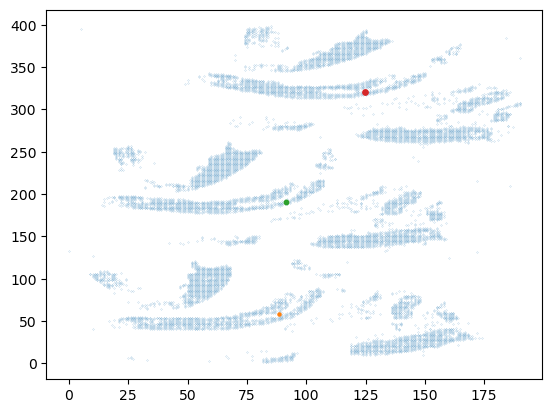

In [36]:
print(centroids)

plt.scatter(co_array.T[0], co_array.T[1], s=1e-2 )
plt.scatter(best_centroids[0][0], best_centroids[0][1], s=5 )
plt.scatter(best_centroids[1][0], best_centroids[1][1], s=10 )
plt.scatter(best_centroids[2][0], best_centroids[2][1], s=15 )
#plt.scatter(centroids[3][0], centroids[3][1], s=20 )
plt.show()

In [38]:
x1, x2, x3

(58.83742904663086, 191.0179443359375, 320.6754150390625)

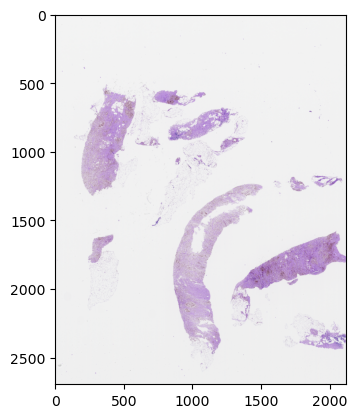

In [41]:
# 좌표 재계산, crop

if best_k == 2:
    crop_image = image[:, : int( (x1+x2)/2  *x_orig / 400 ), :]
elif best_k > 2:
    crop_image = image[:, int((x1+x2)/2 * x_orig/400) : int((x2+x3)/2*x_orig/400), : ]
    #crop_image = image[:, int((x1+x3)/2 * x_orig/400) : , : ]
plt.imshow(crop_image)
plt.show()

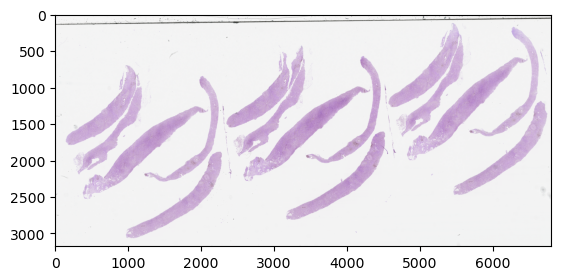

In [330]:
plt.imshow(image)
plt.show()